<a href="https://colab.research.google.com/github/drfperez/YoungPhotonicsCongress/blob/main/ExoplanetSystem.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Generating V1298 Tau Visualizations...


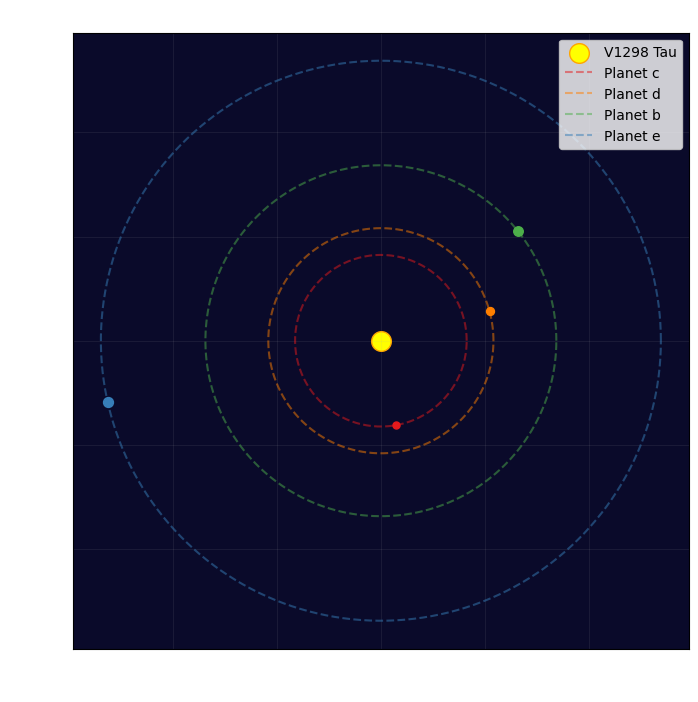

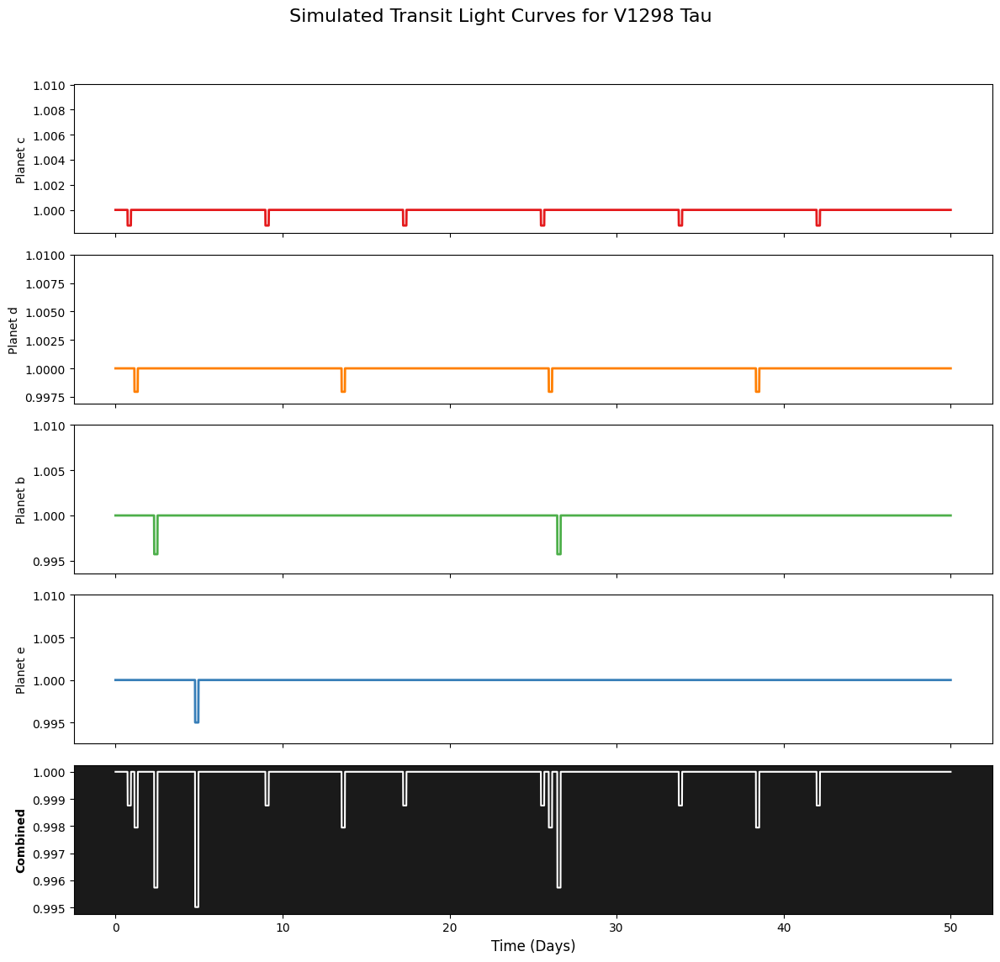

In [2]:

import numpy as np
import matplotlib.pyplot as plt

# --- System Parameters for V1298 Tau ---
# Data sourced from Table 1 of the attached research paper.
# Star: V1298 Tau (Mass: 1.10 M_sun, Radius: 1.32 R_sun)
R_star = 1.32  # Stellar radius in solar radii
R_sun_to_R_earth = 109.076 # Conversion factor

# Planetary Data: [Name, Period (days), a (AU), Radius (R_earth), Color]
planets_data = [
    ["c", 8.249,  0.0824, 5.08,  '#e41a1c'],
    ["d", 12.401, 0.1081, 6.53,  '#ff7f00'],
    ["b", 24.140, 0.1685, 9.41,  '#4daf4a'],
    ["e", 48.678, 0.2689, 10.17, '#377eb8']
]

# --- 1. Top-Down Orbital Visualization ---
def plot_orbits(data):
    fig, ax = plt.subplots(figsize=(8, 8))
    # Plot Star
    ax.scatter(0, 0, s=200, color='yellow', edgecolors='orange', label='V1298 Tau')

    for name, p, a, r, color in data:
        # Draw Orbital Path
        theta = np.linspace(0, 2*np.pi, 200)
        x = a * np.cos(theta)
        y = a * np.sin(theta)
        ax.plot(x, y, '--', color=color, alpha=0.5, label=f'Planet {name}')

        # Draw Planet at an arbitrary position
        angle = np.random.uniform(0, 2*np.pi)
        ax.scatter(a*np.cos(angle), a*np.sin(angle), s=r*5, color=color)

    ax.set_aspect('equal')
    ax.set_facecolor('#0a0a2a')
    ax.set_title("V1298 Tau System: Top-Down Orbit View", color='white', fontsize=14)
    ax.set_xlabel("Distance (AU)", color='white')
    ax.set_ylabel("Distance (AU)", color='white')
    ax.tick_params(colors='white')
    plt.legend(loc='upper right', frameon=True)
    plt.grid(True, alpha=0.1)
    plt.show()

# --- 2. Light Curve Simulation ---
def simulate_light_curve(data, duration_days=50):
    time = np.linspace(0, duration_days, 5000)
    total_flux = np.ones_like(time)

    # Simple box-shaped transit model for didactic purposes
    # Transit Depth = (R_planet / R_star)^2
    # Convert R_star to Earth radii for the ratio
    R_star_earth = R_star * R_sun_to_R_earth

    fig, axes = plt.subplots(len(data) + 1, 1, figsize=(12, 12), sharex=True)

    for i, (name, p, a, r, color) in enumerate(data):
        depth = (r / R_star_earth)**2
        # Simplified transit width (duration) based on period
        duration = 0.2  # Approximate 5-hour transit for didactic view

        # Calculate flux for this specific planet
        planet_flux = np.ones_like(time)
        # Find transit times (centered at n * P)
        for n in range(int(duration_days/p) + 1):
            t0 = n * p + (p * 0.1) # Offset t0 slightly for clarity
            transit_mask = (time > t0 - duration/2) & (time < t0 + duration/2)
            planet_flux[transit_mask] = 1.0 - depth
            total_flux[transit_mask] -= depth # Combined flux

        axes[i].plot(time, planet_flux, color=color, lw=2)
        axes[i].set_ylabel(f"Planet {name}", fontsize=10)
        axes[i].set_ylim(1.0 - depth*1.5, 1.01)

    # Plot the combined light curve
    axes[-1].plot(time, total_flux, color='white', lw=1.5)
    axes[-1].set_ylabel("Combined", fontsize=10, fontweight='bold')
    axes[-1].set_facecolor('#1a1a1a')

    plt.xlabel("Time (Days)", fontsize=12)
    fig.suptitle("Simulated Transit Light Curves for V1298 Tau", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# --- Execution ---
print("Generating V1298 Tau Visualizations...")
plot_orbits(planets_data)
simulate_light_curve(planets_data)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# --- Parameters for V1298 Tau (Source: Nature, Livingston et al. 2026) ---
R_star = 1.32  # Stellar radius (Solar Radii)
R_sun_to_R_earth = 109.076

# Planet Data from Table 1: [Name, Period (P), a (AU), Radius (R_earth), Color]
# Sourced from: Livingston et al. (2026)
planets = [
    {"name": "c", "P": 8.249,  "a": 0.0824, "R": 5.08,  "color": "#e41a1c"},
    {"name": "d", "P": 12.401, "a": 0.1081, "R": 6.53,  "color": "#ff7f00"},
    {"name": "b", "P": 24.140, "a": 0.1685, "R": 9.41,  "color": "#4daf4a"},
    {"name": "e", "P": 48.678, "a": 0.2689, "R": 10.17, "color": "#377eb8"}
]

# --- Setup Visualization ---
fig, (ax_orb, ax_lc) = plt.subplots(1, 2, figsize=(15, 6), gridspec_kw={'width_ratios': [1, 1.5]})
plt.subplots_adjust(wspace=0.3)

# 1. Orbital View Setup
ax_orb.set_aspect('equal')
ax_orb.set_facecolor('#0a0a2a')
ax_orb.set_title("V1298 Tau: Orbital Movement", color='white')
ax_orb.scatter(0, 0, s=300, color='yellow', edgecolors='orange', label='Star')

# Draw static orbital paths
for p in planets:
    theta = np.linspace(0, 2*np.pi, 200)
    ax_orb.plot(p['a']*np.cos(theta), p['a']*np.sin(theta), '--', color=p['color'], alpha=0.3)

# Initialize moving planet points
planet_dots = [ax_orb.scatter([], [], s=p['R']*4, color=p['color'], label=f"Planet {p['name']}") for p in planets]

# 2. Light Curve Setup
ax_lc.set_facecolor('#1a1a1a')
ax_lc.set_title("Real-time Combined Light Curve", color='white')
ax_lc.set_xlabel("Time (Days)")
ax_lc.set_ylabel("Relative Brightness")
ax_lc.set_xlim(0, 50) # Show 50 days of data
ax_lc.set_ylim(0.98, 1.01)

# Combined light curve data
time_data = np.linspace(0, 50, 1000)
total_flux = np.ones_like(time_data)

# Pre-calculate the combined light curve for all transits
R_star_earth = R_star * R_sun_to_R_earth
for p in planets:
    depth = (p['R'] / R_star_earth)**2
    duration = 0.5 # Duration for visualization
    for n in range(int(50/p['P']) + 1):
        t0 = n * p['P']
        mask = (time_data > t0 - duration/2) & (time_data < t0 + duration/2)
        total_flux[mask] -= depth

# Background static light curve
ax_lc.plot(time_data, total_flux, color='gray', alpha=0.3)
# Moving light curve line
lc_line, = ax_lc.plot([], [], color='white', lw=2)
# Current time indicator
time_indicator = ax_lc.axvline(x=0, color='red', linestyle=':', alpha=0.8)

# --- Animation Function ---
def update(frame):
    # 'frame' represents current time in days
    current_time = frame

    # Update Planet Positions
    for i, p in enumerate(planets):
        # Calculate angle based on period (2*pi * time / period)
        angle = 2 * np.pi * (current_time / p['P'])
        x = p['a'] * np.cos(angle)
        y = p['a'] * np.sin(angle)
        planet_dots[i].set_offsets([[x, y]])

    # Update Light Curve (reveal the line up to current time)
    mask = time_data <= current_time
    lc_line.set_data(time_data[mask], total_flux[mask])
    time_indicator.set_xdata([current_time])

    return planet_dots + [lc_line, time_indicator]

# Create animation (50 days simulated over 200 frames)
ani = FuncAnimation(fig, update, frames=np.linspace(0, 50, 200), interval=50, blit=True)

# Clean up orbital view limits
ax_orb.set_xlim(-0.35, 0.35)
ax_orb.set_ylim(-0.35, 0.35)
ax_orb.legend(loc='lower left', fontsize='small', facecolor='black', labelcolor='white')

# Display in Colab
plt.close()
HTML(ani.to_jshtml())